In [2]:

import cv2
import argparse
import numpy as np
import matplotlib.pyplot as plt

from skimage.exposure import rescale_intensity

In [3]:
image_path = "/home/vitor/Downloads/leao.jpg"

In [4]:
import matplotlib.pyplot as plt

def show_image(img, title, colorspace):
    dpi = 96
    figsize = (img.shape[1] / dpi, img.shape[0] / dpi)
    fig, ax = plt.subplots(figsize = figsize, dpi = dpi)
    if colorspace == 'RGB':
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), interpolation = 'spline16')
    if colorspace == 'gray':
        plt.imshow(img, cmap = 'gray')
    plt.title(title, fontsize = 12)
    ax.axis('off')
    plt.show()    

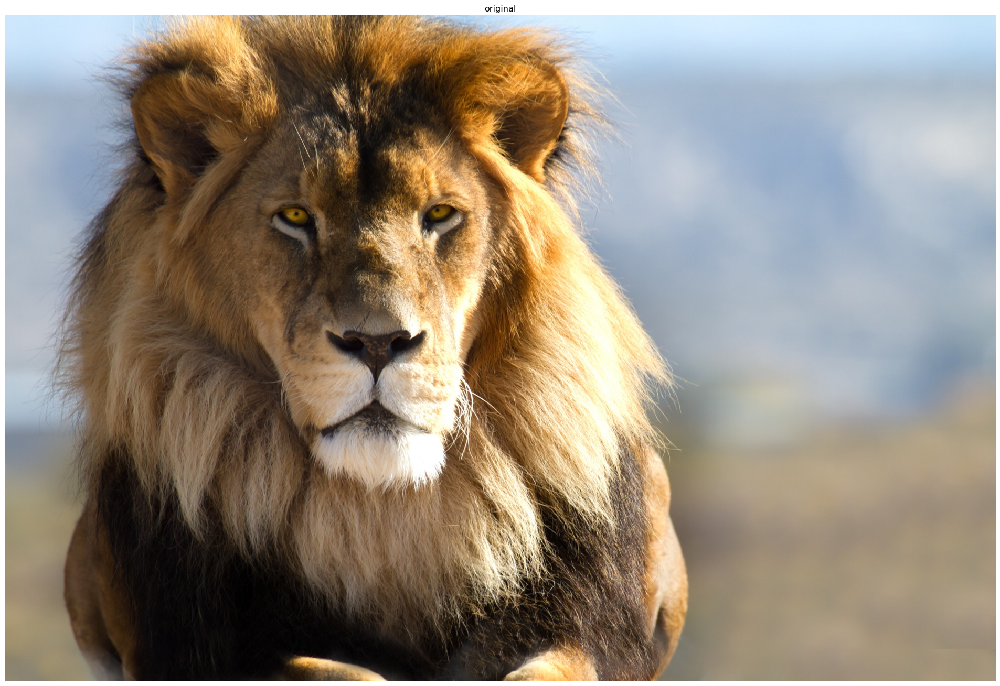

In [5]:
image = cv2.imread(image_path)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

show_image(image, 'original', 'RGB')

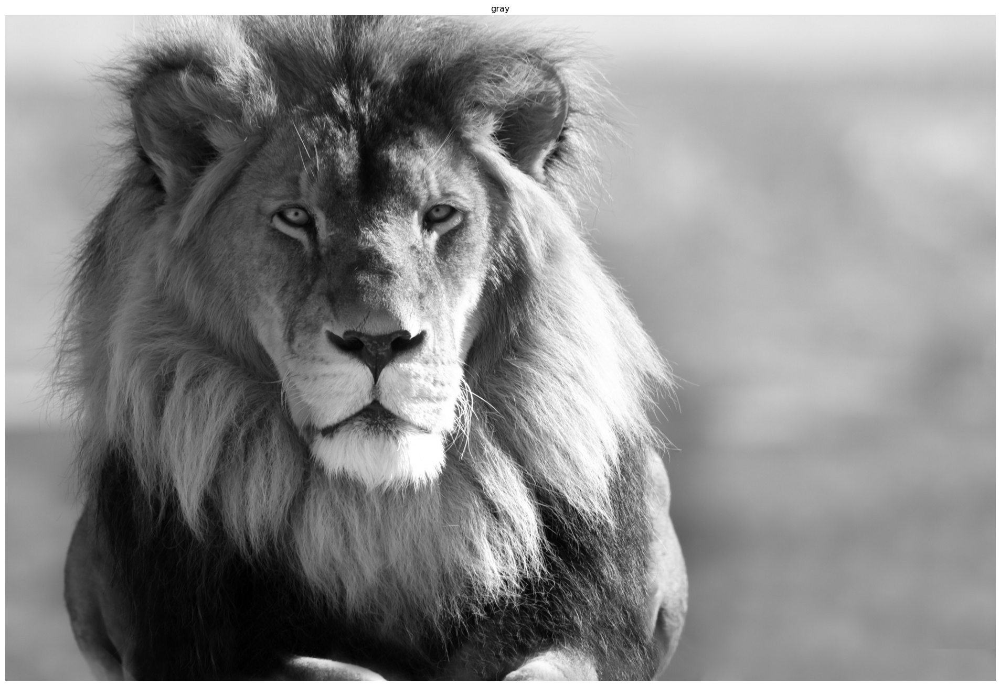

In [6]:
show_image(gray, 'gray', 'RGB')

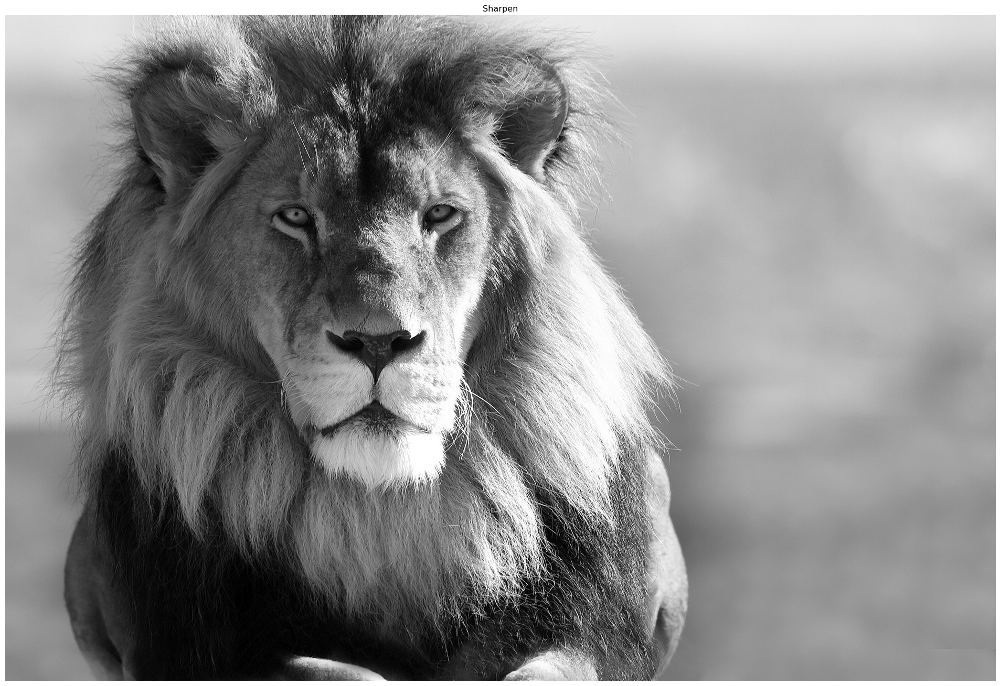

In [7]:
sharpen = np.array(([0, -1, 0],
                    [-1, 5, -1],
                    [0, -1, 0]), dtype="int")


filter_image = cv2.filter2D(gray, -1, sharpen)
show_image(filter_image, 'Sharpen', 'RGB')

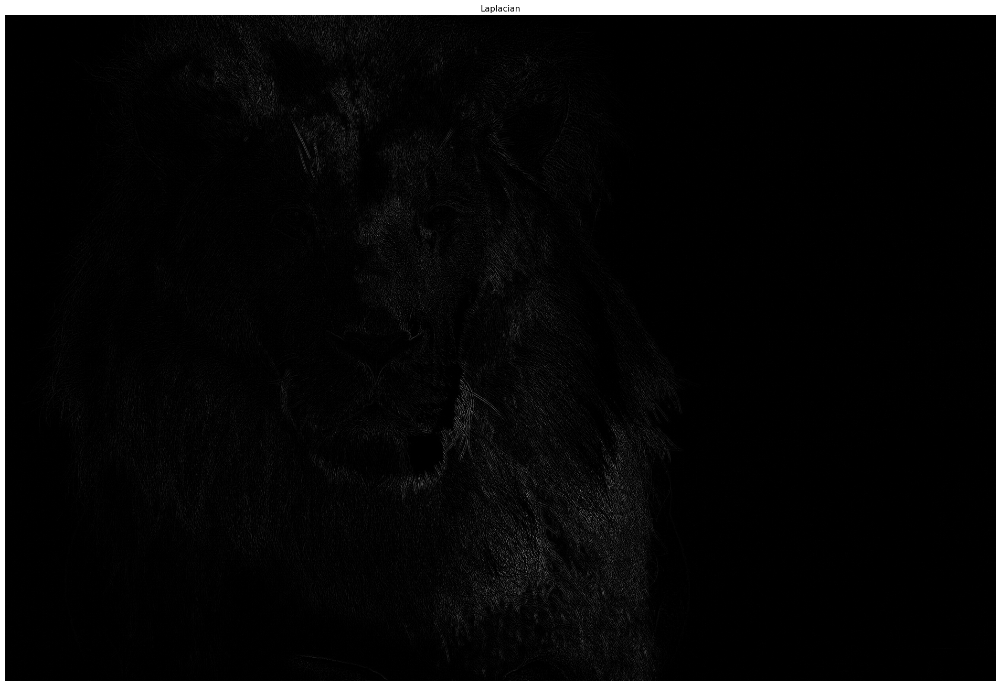

In [8]:
laplacian = np.array(([0, 1, 0],
                      [1, -4, 1],
                      [0, 1, 0]), dtype="int")


filter_image = cv2.filter2D(gray, -1, laplacian)
show_image(filter_image, 'Laplacian', 'RGB')

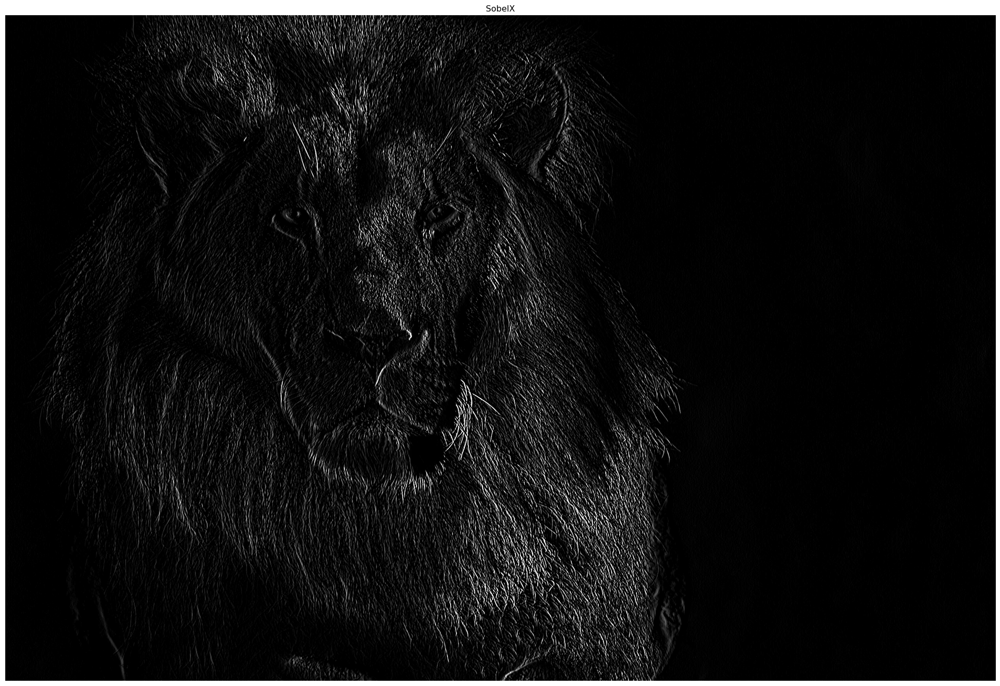

In [9]:
sobelX = np.array(([-1, 0, 1],
                   [-2, 0, 2],
                   [-1, 0, 1]), dtype="int")


filter_image = cv2.filter2D(gray, -1, sobelX)
show_image(filter_image, 'SobelX', 'RGB')

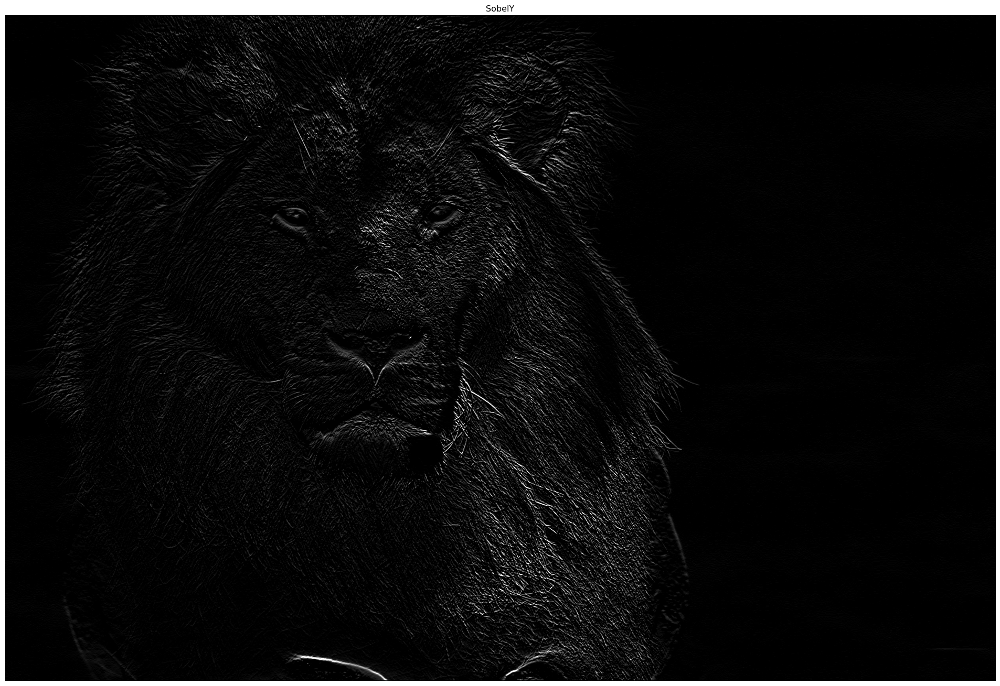

In [10]:
sobelY = np.array(([-1, -2, -1],
                   [0, 0, 0],
                   [1, 2, 1]), dtype="int")

filter_image = cv2.filter2D(gray, -1, sobelY)
show_image(filter_image, 'SobelY', 'RGB')

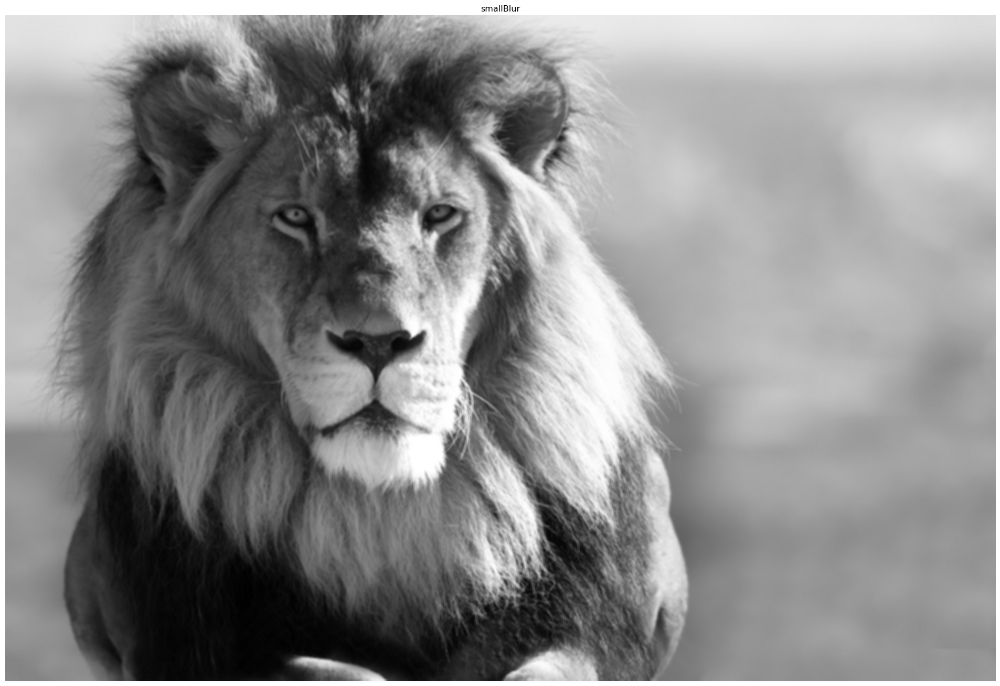

In [11]:
small_blur = np.ones((7, 7), dtype="float") * (1.0 / (7 * 7))
large_blur = np.ones((21, 21), dtype="float") * (1.0 / (21 * 21))

filter_image = cv2.filter2D(gray, -1, small_blur)
show_image(filter_image, 'smallBlur', 'RGB')

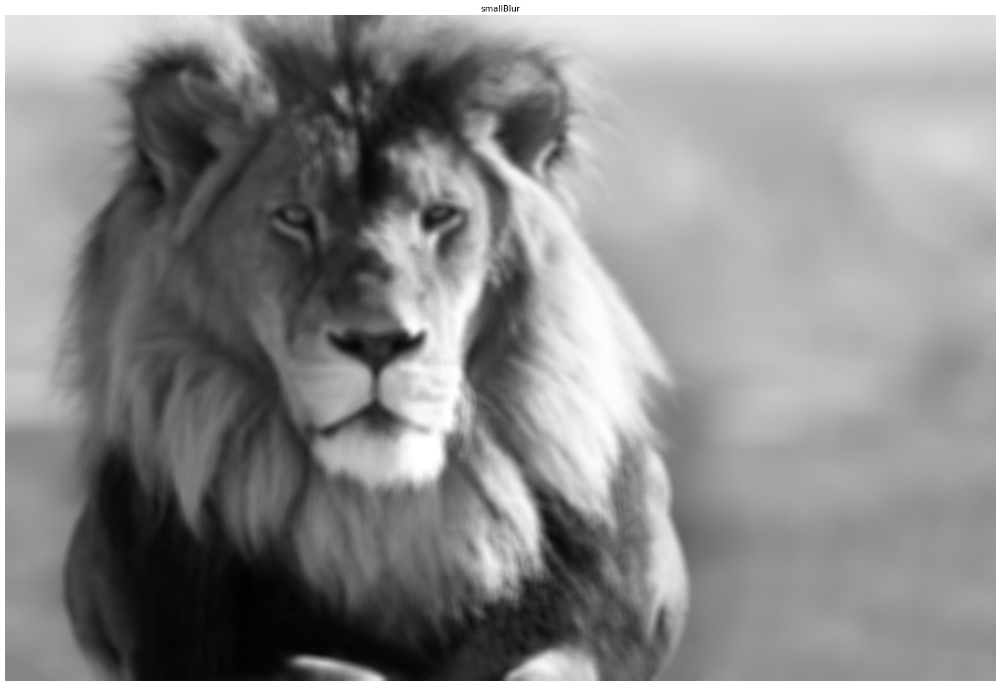

In [12]:
filter_image = cv2.filter2D(gray, -1, large_blur)
show_image(filter_image, 'smallBlur', 'RGB')

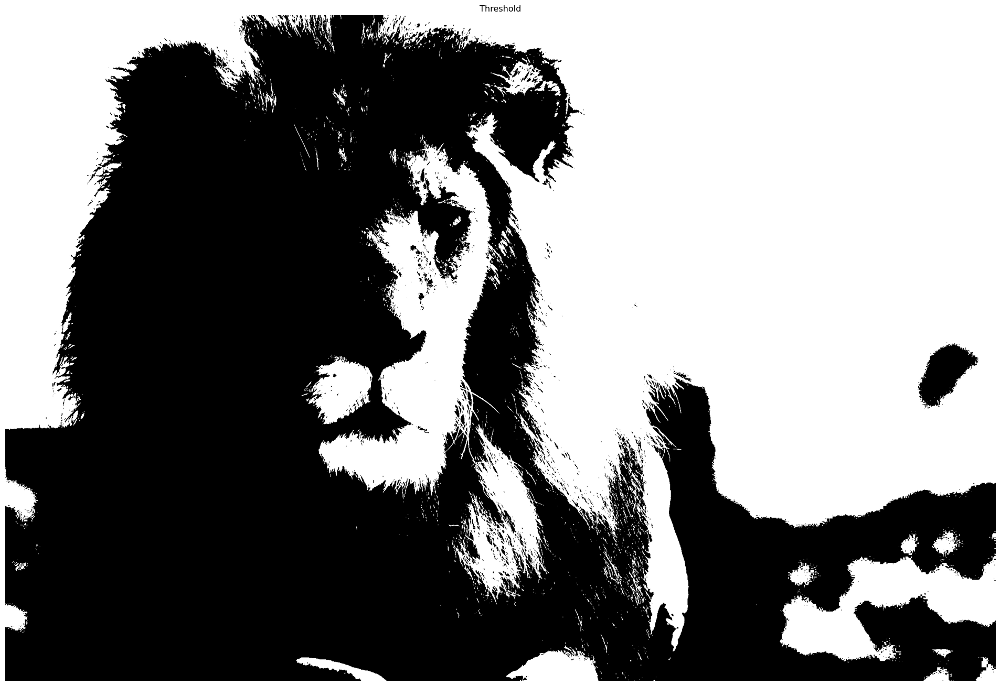

In [16]:
image = cv2.imread('/home/vitor/Downloads/leao.jpg')

image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) 
r ,image = cv2.threshold(image, 150, 255, cv2.THRESH_BINARY)

kernel = np.ones((5,5), np.uint8)

#ax = plt.subplot(232)
#plt.imshow(image, cmap='Greys')
#plt.title('original')
show_image(image, 'Threshold', 'RGB')

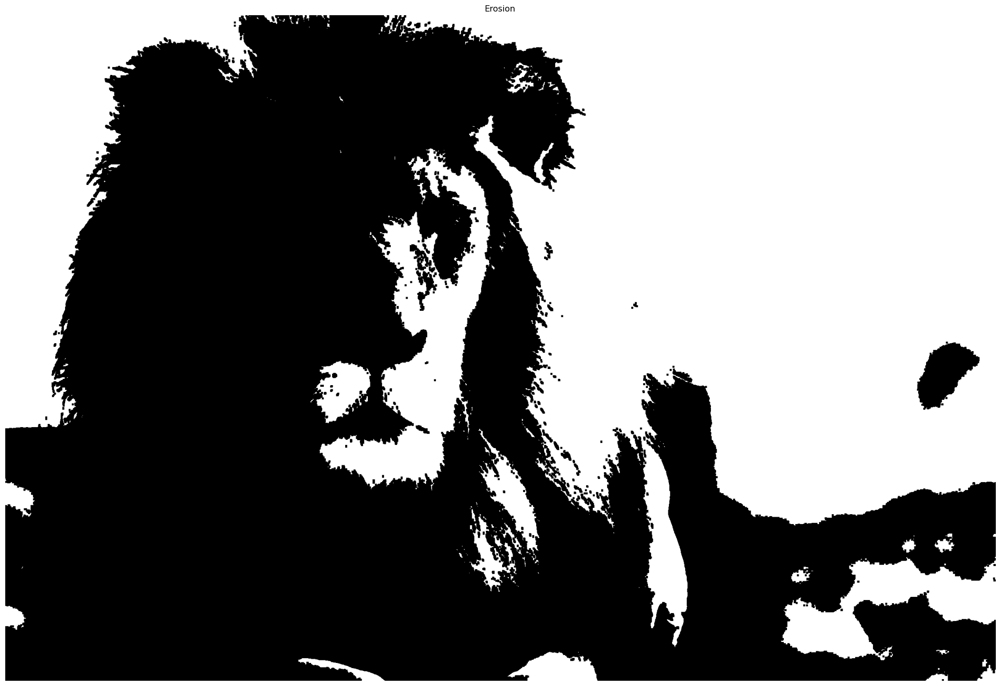

In [17]:
erosion = cv2.erode(image, kernel)
show_image(erosion, 'Erosion', 'RGB')

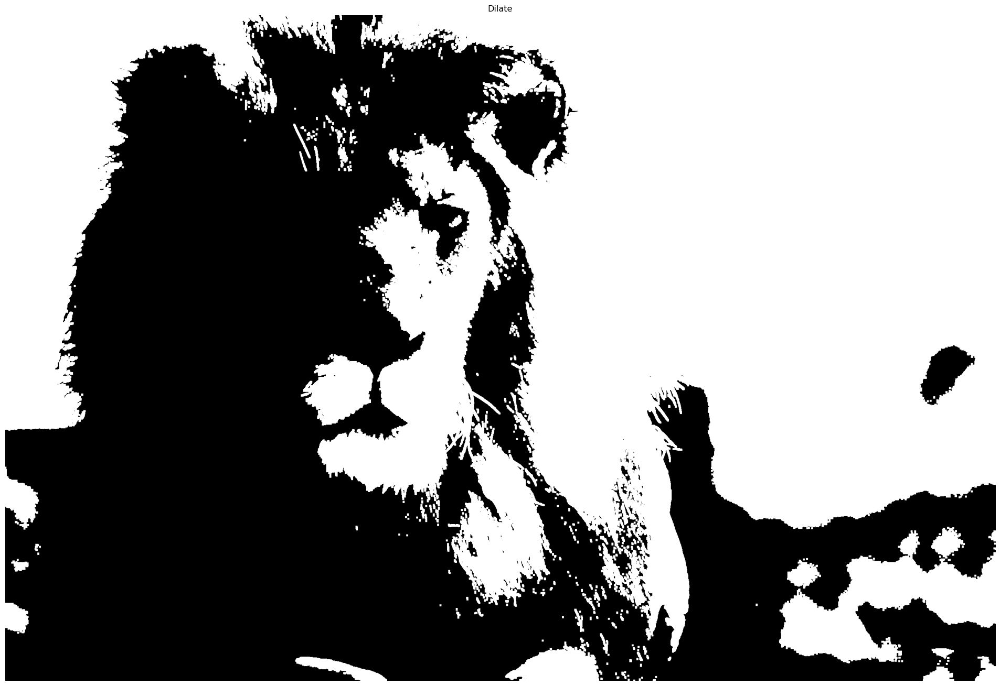

In [18]:
dilate = cv2.dilate(image, kernel)
show_image(dilate, 'Dilate', 'RGB')

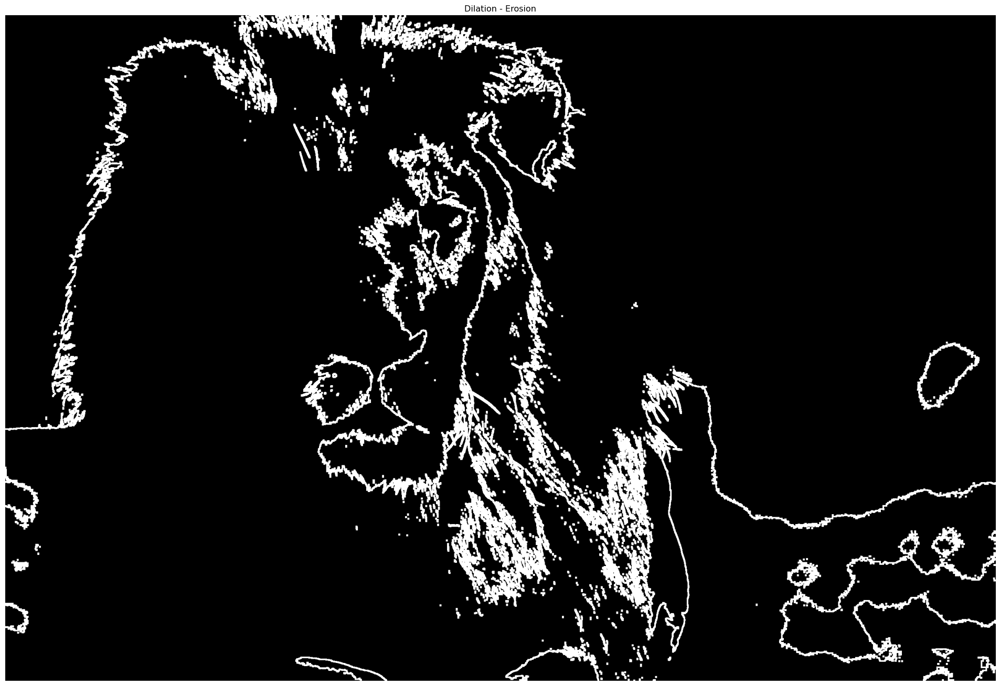

In [19]:
morphological_gradient = cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel)
show_image(morphological_gradient , 'Dilation - Erosion', 'RGB')